In [8]:
import os
import time
import pickle
import networkx as nx
import matplotlib.pyplot as plt

import numpy as np
from numpy import linalg as LA
from numpy import histogram2d

from scipy import signal
from scipy.fft import fft, fftfreq, fftshift
from scipy.signal import find_peaks, butter, filtfilt, welch
from scipy.ndimage import gaussian_filter
from scipy.io import wavfile

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

import utils as ut
from utils import try_except_decorator
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
data_file = "../data/scooter_example_1.wav"
fs, data = wavfile.read(data_file)

# crop data
start_time = 60 # seconds
end_time = 160 # seconds
data = data[int(start_time*fs):int(end_time*fs)]

# data_file = "../data/12062025_example.wav"
# fs, data = wavfile.read(data_file)


# set time annotations
# 1st detection: 3-37 seconds
d1_start = 3
d1_end = 37
# 2nd detection: 91-143 seconds
d2_start = 91
d2_end = 143
# need to account for time cropping
time_annotations = np.zeros_like(data, dtype=int)
if d1_end > start_time and d1_start < end_time:
    s = max(d1_start, start_time) - start_time
    e = min(d1_end, end_time) - start_time
    time_annotations[int(s*fs):int(e*fs)] = 1
if d2_end > start_time and d2_start < end_time:
    s = max(d2_start, start_time) - start_time
    e = min(d2_end, end_time) - start_time
    time_annotations[int(s*fs):int(e*fs)] = 1
print(f"Sample rate: {fs} Hz")
print(f"Data shape: {data.shape}")
print(f"Positive Annotations: {np.sum(time_annotations)} samples, {np.sum(time_annotations)/fs} seconds")
print(f"Negative Annotations: {np.sum(time_annotations==0)} samples, {np.sum(time_annotations==0)/fs} seconds")

f_spec, t, Sxx = ut.get_spectrogram(data, fs, crop_freq=5000)
ut.plot_spectrogram(f_spec, t, Sxx)

Sample rate: 128000 Hz
Data shape: (12800000,)
Positive Annotations: 6656000 samples, 52.0 seconds
Negative Annotations: 6144000 samples, 48.0 seconds


/var/folders/3d/d9dsxkl92nz9mr2x53ct_fvh0000gn/T/ipykernel_26539/3365358342.py:2: WavFileWarning:

Chunk (non-data) not understood, skipping it.



In [10]:
slice = data[int(35*fs):int(40*fs)]

f_spec, t, Sxx = ut.get_spectrogram(slice, fs, nperseg=8192)
ut.plot_spectrogram(f_spec, t, Sxx)

In [11]:
f_welch, pxx = ut.pwelch(data, fs, remove_dc=10, crop_freq=None)

fig = go.Figure()
fig.add_trace(go.Scatter(x=f_welch, y=pxx, mode='lines', name='PSD'))
fig.update_layout(title='Power Spectral Density', xaxis_title='Frequency (Hz)', yaxis_title='Power/Frequency (dB/Hz)')
fig.show()

In [12]:
threshold = 4
detected_frequencies, detected_powers = ut.pwelch_line_detection(data, fs, threshold=threshold, remove_dc=10, crop_freq=None)
print("Detected Frequencies and their Powers:")
for freq, power in zip(detected_frequencies, detected_powers):
    print(f"Frequency: {freq} Hz, Power: {power} dB/Hz")

Detected Frequencies and their Powers:
Frequency: 10.5 Hz, Power: 5.844246113180173 dB/Hz
Frequency: 31.0 Hz, Power: 1.9695924635168223 dB/Hz
Frequency: 307.0 Hz, Power: 3.4808339734192484 dB/Hz
Frequency: 435.5 Hz, Power: 2.5642318290244557 dB/Hz
Frequency: 494.0 Hz, Power: 3.1652075252887157 dB/Hz
Frequency: 512.5 Hz, Power: 4.075131232285989 dB/Hz
Frequency: 543.5 Hz, Power: 23.791964350345168 dB/Hz
Frequency: 558.5 Hz, Power: 3.9334870513146165 dB/Hz
Frequency: 586.5 Hz, Power: 6.200252322368537 dB/Hz
Frequency: 593.0 Hz, Power: 10.259500836117159 dB/Hz
Frequency: 600.5 Hz, Power: 7.239865474960778 dB/Hz
Frequency: 614.5 Hz, Power: 6.877410740416914 dB/Hz
Frequency: 628.5 Hz, Power: 2.1363689688718646 dB/Hz
Frequency: 642.5 Hz, Power: 28.4156336495432 dB/Hz
Frequency: 670.0 Hz, Power: 4.910088746156742 dB/Hz
Frequency: 691.5 Hz, Power: 7.266749195230593 dB/Hz
Frequency: 768.0 Hz, Power: 1.9838890063494747 dB/Hz
Frequency: 780.5 Hz, Power: 2.3093390730141836 dB/Hz
Frequency: 782.5 H

In [13]:
fig = make_subplots(rows=2, cols=1)

# spectrogram
fig.add_trace(go.Heatmap(z=Sxx, x=t, y=f_spec, colorscale='Viridis', showscale=False), row=1, col=1)
fig.update_yaxes(title_text='Frequency (Hz)', row=1, col=1)
fig.update_xaxes(title_text='Time (s)', row=1, col=1)

fig.add_trace(go.Scatter(x=f_welch, y=pxx, mode='lines', line=dict(color='blue'), showlegend=False), row=2, col=1)
fig.update_layout(title='Power Spectral Density with Detections', xaxis_title='Frequency (Hz)', yaxis_title='Power/Frequency (dB/Hz)')

# overlay detections on spectrogram
for freq in detected_frequencies:
    fig.add_trace(go.Scatter(x=t, y=[freq]*len(t), mode='lines', line=dict(color='red', width=1), showlegend=False), row=1, col=1)
    fig.add_trace(go.Scatter(x=[freq], y=[detected_powers[np.where(detected_frequencies==freq)[0][0]]], mode='markers', marker=dict(color='red', size=8), showlegend=False), row=2, col=1)

fig.update_layout(height=800, width=800, title_text="Spectrogram and PSD with Detected Frequencies")

fig.show()

---

In [15]:
detected_frequencies, detected_powers = ut.pwelch_line_detection(slice, fs, threshold=4, remove_dc=10, crop_freq=None)
peak_vis = ut.calc_vis_graph_generalized(x=detected_frequencies, y=detected_powers)

fig = go.Figure()
fig.add_trace(go.Heatmap(z=peak_vis, colorscale='Greys', showscale=False))

fig.update_layout(height=600, width=600)
fig.show()

---

In [16]:
detected_frequencies, detected_powers = ut.pwelch_line_detection(slice, fs, threshold=4, remove_dc=10, crop_freq=None)
edges = ut.calc_vis_graph_generalized(x=detected_frequencies, y=detected_powers, return_Adj=False)

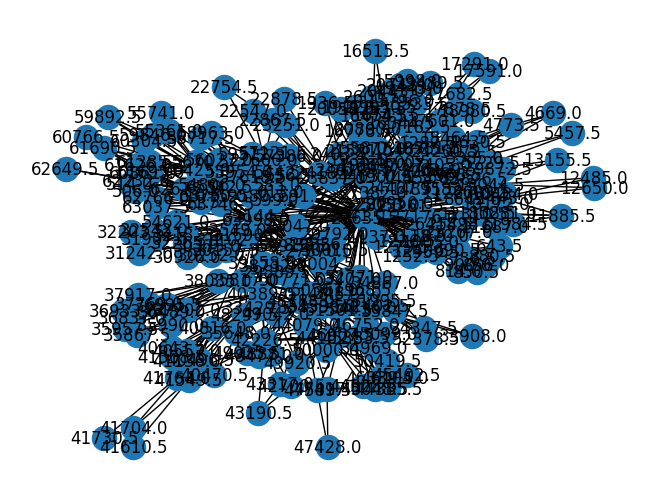

In [17]:
G = nx.Graph()
G.add_nodes_from(detected_frequencies)
G.add_edges_from(edges)

nx.draw(G, with_labels=True)
plt.show()

In [18]:
vals, vecs, counts = ut.graph_decomposition(peak_vis)

fig = px.scatter(x=range(len(vals)), y=vals)
fig.show()

In [19]:
unique_degree, degree_distribution = ut.calc_degree_distribution(peak_vis)

fig = px.bar(x=unique_degree, y=degree_distribution, labels={'x':'Degree', 'y':'Frequency'})
fig.update_layout(title='Degree Distribution of Visibility Graph')
fig.show()

In [20]:
from scipy.special import factorial

# fit to poison distribution
lambda_est = np.sum(unique_degree * degree_distribution) / np.sum(degree_distribution)
poisson_pmf = (lambda_est ** unique_degree) * np.exp(-lambda_est) / np.array([factorial(k) for k in unique_degree])
fig = px.bar(x=unique_degree, y=degree_distribution, labels={'x':'Degree', 'y':'Frequency'}, title='Degree Distribution with Poisson Fit')
fig.add_trace(go.Scatter(x=unique_degree, y=poisson_pmf * np.sum(degree_distribution), mode='lines', name='Poisson Fit', line=dict(color='red')))
fig.show()

---

In [21]:
f_cep, cepstrum = ut.pwelch(pxx, fs=len(pxx))

fig = go.Figure()
fig.add_trace(go.Scatter(x=f_cep, y=cepstrum, mode='lines', name='Cepstrum'))
fig.update_layout(title='Cepstrum', xaxis_title='Quefrency (samples)', yaxis_title='Amplitude')
fig.show()

/opt/anaconda3/envs/dev/lib/python3.13/site-packages/scipy/signal/_spectral_py.py:790: UserWarning:

nperseg = 256002 is greater than input length  = 128001, using nperseg = 128001

